<a href="https://colab.research.google.com/github/rohitgupta29/AI7-/blob/master/Breathing_2020.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
#imports
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import os

import folium

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

import math
import random
from datetime import timedelta, datetime, date


import warnings
warnings.filterwarnings('ignore')
#color pallette

cnf = '#393e46'
dth = '#ff2e63'
rec = '#21bf73'
act = '#fe9801'


import cufflinks
cufflinks.go_offline()
cufflinks.set_config_file(world_readable=True, theme='pearl')

import plotly as py
py.offline.init_notebook_mode(connected = True)

In [3]:
path1 = "https://raw.githubusercontent.com/laxmimerit/Covid-19-Preprocessed-Dataset/master/preprocessed/country_daywise.csv"

path2 = "https://raw.githubusercontent.com/laxmimerit/Covid-19-Preprocessed-Dataset/master/preprocessed/countrywise.csv"

path3 = "https://raw.githubusercontent.com/laxmimerit/Covid-19-Preprocessed-Dataset/master/preprocessed/covid_19_data_cleaned.csv"

path4 = "https://raw.githubusercontent.com/laxmimerit/Covid-19-Preprocessed-Dataset/master/preprocessed/daywise.csv"


In [5]:
df = pd.read_csv(path3, parse_dates = ['Date']) 
country_daywise = pd.read_csv(path1, parse_dates = ['Date'])
countrywise = pd.read_csv(path2)
daywise = pd.read_csv(path4, parse_dates = ['Date'])


df['Province/State'] = df['Province/State'].fillna("")

In [8]:
confirmed = df.groupby('Date').sum()['Confirmed'].reset_index()
recovered = df.groupby('Date').sum()['Recovered'].reset_index()
deaths = df.groupby('Date').sum()['Deaths'].reset_index()


Worldwide Total Confirmed, Recovered, and Deaths

In [9]:
fig = go.Figure()

fig.add_trace(go.Scatter(x = confirmed['Date'], y = confirmed['Confirmed'], mode = 'lines + markers',name = 'Confirmed', line = dict(color = "Orange", width =2 )))

fig.add_trace(go.Scatter(x = confirmed['Date'], y = recovered['Recovered'], mode = 'lines + markers',name = 'Recovered', line = dict(color = "Green", width =2 )))

fig.add_trace(go.Scatter(x = confirmed['Date'], y = deaths['Deaths'], mode = 'lines + markers',name = 'Confirmed', line = dict(color = "Yellow", width =2 )))

fig.update_layout(title = 'Worldwide Covid-19 Cases', xaxis_tickfont_size = 14, yaxis = dict(title = 'Number of cases'))

fig.show()

Cases Density Animation on World Map

In [10]:
df['Date'] = df['Date'].astype(str)

In [11]:
fig = px.density_mapbox(df, lat = 'Lat', lon = 'Long', hover_name = 'Country', hover_data = ['Confirmed','Recovered','Deaths'], animation_frame = 'Date',color_continuous_scale = 'Portland',radius = 7, zoom = 0,height = 700 )
fig.update_layout(title = 'Worldwide Covid-19 Cases with Time Laps')
fig.update_layout(mapbox_style = 'open-street-map', mapbox_center_lon = 0)

fig.show()

In [12]:
df['Date'] = pd.to_datetime(df['Date'])

Cases Over the Time with Area Plot

In [13]:
temp = df.groupby('Date')['Confirmed','Deaths','Recovered','Active'].sum().reset_index()
temp = temp[temp['Date'] ==max(temp['Date'])].reset_index(drop = True)

In [14]:
tm = temp.melt(id_vars = 'Date',value_vars = ['Active','Deaths','Recovered'])

fig = px.treemap(tm, path = ['variable'] , values = 'value', height = 250,width = 800, color_disrete_sequence = [act,rec,dth])

fig.data[0].textinfo = 'label + text + value'

fig.show()

TypeError: ignored

In [15]:
temp = df.groupby('Date')['Recovered','Active','Deaths'].sum().reset_index()
temp = temp.melt(id_vars = 'Date',value_vars = ['Recovered','Deaths','Active'], var_name = 'Case', value_name = 'Count')
temp

fig = px.area(temp, x = 'Date', y = 'Count', color = 'Case', height = 600, title = 'Cases over time',color_discrete_sequence = [rec, dth, act])

fig.update_layout(xaxis_rangeslider_visible = True)

fig.show()

In [16]:
# Worldwide Cases on Folium Maps

temp = df[df['Date'] == max(df['Date'])]
temp

m = folium.Map(location= [0,0], tiles= 'cartodbpositron', min_zoom = 1, max_zoom = 4, zoom_start = 1)

for i in range(0,len(temp)):
  folium.Circle(location = [temp.iloc[i]['Lat'], temp.iloc[i]['Long']],color = 'crimson', fill = 'crimson',
                tooltips = '<li><bold> Country: ' + str(temp.iloc[i]['Country']) +
                '<li><bold> Province: ' + str(temp.iloc[i]['Province/State'])
                + '<li><bold> Confirmed: ' + str(temp.iloc[i]['Confirmed'])
                + '<li><bold> Deaths: ' + str(temp.iloc[i]['Deaths']),
                radius = int(temp.iloc[i]['Confirmed'])** 0.5).add_to(m)
                

Confirmed Cases With Choropleth Map

In [17]:
fig = px.choropleth(country_daywise,locations = 'Country',locationmode = 'country names',color = np.log(country_daywise['Confirmed']),
        hover_name = 'Country', animation_frame = country_daywise['Date'].dt.strftime('%Y-%m-%d'), 
        title = 'Cases over time', color_continuous_scale = px.colors.sequential.Inferno)

fig.update(layout_coloraxis_showscale = True)

fig.show()

Deaths and Recoveries per 100 Cases

In [18]:
fig_c = px.bar(daywise, x = 'Date', y = 'Confirmed', color_discrete_sequence = [act])
fig_d = px.bar(daywise, x = 'Date', y = 'Deaths', color_discrete_sequence = [dth])

fig = make_subplots(rows = 1, cols = 2, shared_xaxes = False, horizontal_spacing = 0.1,
                    subplot_titles = ('COnfirmed Cases', 'Death Cases'))

fig.add_trace(fig_c['data'][0], row = 1, col = 1)

fig.add_trace(fig_d['data'][0], row =1, col =2)

fig.update_layout(height = 400)

fig.show()

Confirmed and Death Cases with Static Colormap

In [19]:
fig_c = px.choropleth(countrywise, locations = 'Country', locationmode = 'country names',color = np.log(countrywise['Confirmed']), hover_name = 'Country',
                      hover_data = ['Confirmed'])
temp = countrywise[countrywise['Deaths']> 0]
fig_d = px.choropleth(temp, locations = 'Country', locationmode = 'country names',
              color = np.log(temp['Deaths']), hover_name = 'Country',
              hover_data = ['Deaths'])


fig = make_subplots(rows = 1, cols = 2, subplot_titles = ['Confirmed', 'Deaths'],
                    specs = [[{'type': 'choropleth'},{'type':'choropleth'}]])

fig.add_trace(fig_c['data'][0],row =1, col = 1)
fig.add_trace(fig_c['data'][0],row =1, col = 2)

fig.update(layout_coloraxis_showscale = False)
fig.show()

In [20]:
fig1 = px.line(daywise, x = 'Date', y = 'Deaths / 100 Cases', color_discrete_sequence = [dth])

fig2 = px.line(daywise, x = 'Date', y = 'Recovered / 100 Cases', color_discrete_sequence = [rec])
fig3 = px.line(daywise, x = 'Date', y = 'Deaths / 100 Recovered', color_discrete_sequence = [rec])

fig = make_subplots(rows = 1, cols = 3, shared_xaxes = False, 
                   subplot_titles = ('Deaths / 100 Cases','Recovered / 100 Cases', 'Deaths/ 100 Recovered'))

fig.add_trace(fig1['data'][0],row =1, col =1)
fig.add_trace(fig1['data'][0],row =1, col =2)
fig.add_trace(fig1['data'][0],row =1, col =3)

fig.update_layout(height = 400)

fig.show()


Top 15 Countries Analysis

In [21]:
top = 15

fig_c = px.bar(countrywise.sort_values('Confirmed').tail(top), x = 'Confirmed', y = 'Country',
               text = 'Confirmed', orientation = 'h', color_discrete_sequence = [act])
fig_d = px.bar(countrywise.sort_values('Deaths').tail(top), x = 'Deaths', y = 'Country',
               text = 'Deaths', orientation = 'h', color_discrete_sequence = [dth])


fig_a = px.bar(countrywise.sort_values('Active').tail(top), x = 'Active', y = 'Country',
               text = 'Active', orientation = 'h', color_discrete_sequence = ['#434343'])
fig_r = px.bar(countrywise.sort_values('Recovered').tail(top), x = 'Recovered', y = 'Country',
               text = 'Recovered', orientation = 'h', color_discrete_sequence = [rec])

#dc = death/100 cases

fig_dc = px.bar(countrywise.sort_values('Deaths / 100 Cases').tail(top), x = 'Deaths / 100 Cases', y = 'Country',
               text = 'Deaths / 100 Cases', orientation = 'h', color_discrete_sequence = ['#f84351'])
fig_rc = px.bar(countrywise.sort_values('Recovered / 100 Cases').tail(top), x = 'Recovered / 100 Cases', y = 'Country',
               text = 'Recovered / 100 Cases', orientation = 'h', color_discrete_sequence = ['#a45398'])


fig_nc = px.bar(countrywise.sort_values('New Cases').tail(top), x = 'New Cases', y = 'Country',
               text = 'New Cases', orientation = 'h', color_discrete_sequence = ['#f84351'])
temp = countrywise[countrywise['Population'] > 1000000]
fig_p = px.bar(temp.sort_values('Cases / Million People').tail(top), x = 'Cases / Million People', y = 'Country',
               text = 'Cases / Million People', orientation = 'h', color_discrete_sequence = ['#a45398'])



fig_wc = px.bar(countrywise.sort_values('1 week change').tail(top), x = '1 week change', y = 'Country',
               text = '1 week change', orientation = 'h', color_discrete_sequence = ['#c84351'])
temp = countrywise[countrywise['Confirmed'] > 100]
fig_wi = px.bar(temp.sort_values('1 week % increase').tail(top), x = '1 week % increase', y = 'Country',
               text = '1 week % increase', orientation = 'h', color_discrete_sequence = ['#a45398'])


fig = make_subplots(rows = 5, cols = 2, shared_xaxes = False, horizontal_spacing = 0.2, 
                    vertical_spacing = .05, subplot_titles = ('Confirmed Cases', 'Deaths Reported','Recovered Cases', 'Active Cases',
                                                              'Deaths / 100 Cases','Recovered / 100 Cases'
                        , 'New Cases', 'Cases / Million People','1 week change', '1 week % increase'     ))


fig.add_trace(fig_c['data'][0], row = 1, col = 1)
fig.add_trace(fig_d['data'][0], row = 1, col = 2)

fig.add_trace(fig_r['data'][0], row = 2, col = 1)
fig.add_trace(fig_a['data'][0], row = 2, col = 2)


fig.add_trace(fig_dc['data'][0], row = 3, col = 1)
fig.add_trace(fig_rc['data'][0], row = 3, col = 2)

fig.add_trace(fig_dc['data'][0], row = 4, col = 1)
fig.add_trace(fig_rc['data'][0], row = 4, col = 2)


fig.add_trace(fig_wc['data'][0], row = 5, col = 1)
fig.add_trace(fig_wi['data'][0], row = 5, col = 2)




fig.update_layout(height = 3000)
fig.show()

Growth Rate after 100 cases in Each Country

In [22]:
gt_100 = country_daywise[country_daywise['Confirmed'] > 100]['Country'].unique()
temp = df[df['Country'].isin(gt_100)]
temp = temp.groupby(['Country','Date'])['Confirmed'].sum().reset_index()

temp = temp[temp['Confirmed'] > 100]


min_date = temp.groupby('Country')['Date'].min().reset_index()
min_date.columns = ['Country','Min Date']


from_100th_case = pd.merge(temp, min_date, on = 'Country')
from_100th_case['N days'] = (from_100th_case['Date'] - from_100th_case['Min Date']).dt.days


fig = px.line(from_100th_case, x = 'N days', y = 'Confirmed', color = 'Country', 
              title = 'N days from 100 case', height = 600)

fig.show()

Growth rate after 100000 cases

In [23]:
gt_100000 = country_daywise[country_daywise['Confirmed'] > 100000]['Country'].unique()
temp = df[df['Country'].isin(gt_100000)]
temp = temp.groupby(['Country','Date'])['Confirmed'].sum().reset_index()

temp = temp[temp['Confirmed'] > 100000]


min_date = temp.groupby('Country')['Date'].min().reset_index()
min_date.columns = ['Country','Min Date']


from_100000th_case = pd.merge(temp, min_date, on = 'Country')
from_100000th_case['N days'] = (from_100000th_case['Date'] - from_100000th_case['Min Date']).dt.days


fig = px.line(from_100000th_case, x = 'N days', y = 'Confirmed', color = 'Country', 
              title = 'N days from 100000 case', height = 600)

fig.show()

Tree Map Analysis for Confirmed Cases

In [24]:
full_latest = df[df['Date'] == max(df['Date'])]

fig = px.treemap(full_latest.sort_values(by = 'Confirmed', ascending = False).reset_index(drop = True), 
                 path = ['Country', 'Province/State'], values = 'Confirmed', height = 700,
                 title = 'Number of Confirmed Cases', color_discrete_sequence = px.colors.qualitative.Dark2)

fig.data[0].textinfo = 'label+text+value'

fig.show()

TypeError: ignored

Deaths Cases

In [25]:
full_latest = df[df['Date'] == max(df['Date'])]

fig = px.treemap(full_latest.sort_values(by = 'Deaths', ascending = False).reset_index(drop = True), 
                 path = ['Country', 'Province/State'], values = 'Deaths', height = 700,
                 title = 'Number of Deaths Cases', color_discrete_sequence = px.colors.qualitative.Dark2)

fig.data[0].textinfo = 'label+text+value'

fig.show()

TypeError: ignored

In [26]:
india_age = "https://raw.githubusercontent.com/rohitgupta29/AI7-/master/AgeGroupDetails.csv"
india_tests = "https://raw.githubusercontent.com/rohitgupta29/AI7-/master/StatewiseTestingDetails.csv"
india_india = "https://raw.githubusercontent.com/rohitgupta29/AI7-/master/covid_19_india.csv"
india_hosp = "https://raw.githubusercontent.com/rohitgupta29/AI7-/master/HospitalBedsIndia.csv"
india_pop = "https://raw.githubusercontent.com/rohitgupta29/AI7-/master/population_india_census2011.csv"
india_labs = "https://raw.githubusercontent.com/rohitgupta29/AI7-/master/ICMRTestingLabs.csv"

In [27]:
#reading the files
df_age = pd.read_csv(india_age,index_col = 0)
df_india = pd.read_csv(india_india,index_col= 0)
df_tests = pd.read_csv(india_tests)
df_hosp = pd.read_csv(india_hosp,index_col=0)
df_pop = pd.read_csv(india_pop,index_col= 0)
df_labs = pd.read_csv(india_labs)

In [28]:
#Droping redundant data

df_india.drop(df_india[df_india['State/UnionTerritory'] == 'Telangana***'].index, inplace = True)

df_india.drop(df_india[df_india['State/UnionTerritory'] == 'Telengana***'].index,inplace = True)

df_india.drop(df_india[df_india['State/UnionTerritory'] == 'Telengana'].index,inplace = True)

df_india.drop(df_india[df_india['State/UnionTerritory'] == 'Unassigned'].index,inplace = True)



In [29]:
#Some preprocessing

df_india['Date'] = pd.to_datetime(df_india['Date'], dayfirst = True)

df_india['Date'] = df_india['Date'].dt.strftime('%m%d%Y')

#Dropping negative column as we already have 'TotalSample' and 'Positive'

df_tests.drop('Negative', axis = 1, inplace = True)

df_pop.set_index('State / Union Territory', inplace = True)

In [30]:
#Filling in Missing Data

#For missing 'Positive' cases of COVID, the previous known value is filled in.
df_tests['Positive'].fillna(method = 'ffill', inplace = True)

#For missing 'Sub=District Hospitals' values, assumed 0 hospitals are present in state.

df_hosp.fillna(0,inplace = True)

In [31]:
#making a database of cases of every state for the last day of reporting

state_report = df_india.groupby(by = 'State/UnionTerritory').max().reset_index()

state_report['Active'] = (state_report['Confirmed'] - (state_report['Cured'] + state_report['Deaths']))

state_report['Deaths per 100 Cases'] = round(((state_report['Deaths']/state_report['Confirmed'])*100),2)

state_report.drop(columns = ['Time', 'ConfirmedIndianNational', 'ConfirmedForeignNational'], inplace = True)

state_report.style.background_gradient(cmap = 'Greens', subset = ['Cured'])\
.background_gradient(cmap = 'Reds',subset = ['Deaths'])\
.background_gradient(cmap = 'Blues', subset = ['Confirmed'])\
.background_gradient(cmap = 'Greys', subset = ['Active'])\
.background_gradient(cmap = 'Reds', subset = ['Deaths per 100 Cases']).format('{:.2f}', subset = ['Deaths per 100 Cases'])

,State/UnionTerritory,Date,Cured,Deaths,Confirmed,Active,Deaths per 100 Cases
0,Andaman and Nicobar Islands,08122020,829,21,1900,1050,1.11
1,Andhra Pradesh,08122020,161425,2296,254146,90425,0.90
2,Arunachal Pradesh,08122020,1659,3,2430,768,0.12
3,Assam,08122020,47209,161,68999,21629,0.23
4,Bihar,08122020,59786,416,90321,30119,0.46
5,Cases being reassigned to states,07182020,0,0,9265,9265,0.00
6,Chandigarh,08122020,1023,26,1751,702,1.48
7,Chhattisgarh,08122020,9508,109,13498,3881,0.81
8,Dadar Nagar Haveli,06112020,2,0,26,24,0.00
9,Dadra and Nagar Haveli and Daman and Diu,08122020,1248,2,1696,446,0.12


In [32]:
#State latitudes and longitudes found using geopy for Map Visualization.

Location_dict = {'Andaman and Nicobar Islands': (10.2188344, 92.5771329),
 'Andhra Pradesh': (15.9240905, 80.1863809),
 'Arunachal Pradesh': (27.6891712, 96.4597226),
 'Assam': (26.4073841, 93.2551303),
 'Bihar': (25.6440845, 85.906508),
 'Chandigarh': (30.7334421, 76.7797143),
 'Chhattisgarh': (21.6637359, 81.8406351),
 'Daman & Diu': (20.42000485, 72.86376290300566),
 'Delhi': (28.6517178, 77.2219388),
 'Goa': (15.3004543, 74.0855134),
 'Gujarat': (22.41540825, 72.03149703699282),
 'Haryana': (29.0, 76.0),
 'Himachal Pradesh': (31.81676015, 77.34932051968858),
 'Jammu and Kashmir': (33.5574473, 75.06152),
 'Jharkhand': (23.4559809, 85.2557301),
 'Karnataka': (14.5203896, 75.7223521),
 'Kerala': (10.3528744, 76.5120396),
 'Ladakh': (33.9456407, 77.6568576),
 'Madhya Pradesh': (23.9699282, 79.39486954625225),
 'Maharashtra': (19.531932, 76.0554568),
 'Manipur': (24.7208818, 93.9229386),
 'Meghalaya': (25.5379432, 91.2999102),
 'Mizoram': (23.2146169, 92.8687612),
 'Nagaland': (26.1630556, 94.5884911),
 'Odisha': (20.5431241, 84.6897321),
 'Puducherry': (11.9340568, 79.8306447),
 'Punjab': (30.9293211, 75.5004841),
 'Rajasthan': (26.8105777, 73.7684549),
 'Sikkim': (27.601029, 88.45413638680145),
 'Tamil Nadu': (10.9094334, 78.3665347),
 'Telangana': (17.8495919, 79.1151663),
 'Telengana': (17.329125, 78.5822228),
 'Tripura': (23.7750823, 91.7025091),
 'Uttar Pradesh': (27.1303344, 80.859666),
 'Uttarakhand': (30.091993549999998, 79.32176659343018),
 'West Bengal': (22.9964948, 87.6855882)}

In [33]:
map_states = state_report.drop(index=[5,8,9,36],errors = 'ignore')
map_states.reset_index(inplace = True,drop = True)

india_map = folium.Map(location=[21, 78], zoom_start=5, tiles = 'cartodbpositron',min_zoom = 5, max_zoom = 7,control_scale=True)


for i in range(0,len(map_states)):
    state = map_states['State/UnionTerritory'][i]
    cases = map_states['Confirmed'][i]  
    deaths = map_states['Deaths'][i]
    cured = map_states['Cured'][i]
    
    location = Location_dict[state]
    
    folium.Circle([location[0],location[1]],radius = float(cases * 0.8),color = '#10B4AB',fill_color = 'cyan',
                  fill = True, 
                  tooltip = "<h5 style = 'text-align:center;font-weight:bold'>"+state+"</h5>"\
                  + "<div style = 'text-align:center;'>" + "<b>"+'Confirmed : '+"</b>"+ str(cases)+"</div>"\
                  + "<div style = 'text-align:center;'>" + "<b>"+'Recovered : '+"</b>"+ str(cured)+"</div>"\
                  + "<div style = 'text-align:center;'>" + "<b>"+'Deaths : '+"</b>"+ str(deaths)+"</div>").add_to(india_map)
    
india_map.save('indiamap.html')
india_map

We can deduce that the worst-struck states of India are the ones with densely packed urban areas, like Mumbai in Maharashtra, Chennai in Tamil Nadu and New Delhi. Let's see how the total national confirmed cases are distributed.

Data Analysis

In [34]:
state_report['per cent Confirmed'] = (state_report['Confirmed']*100/state_report.sum()['Confirmed'])
pie = state_report.drop(index = state_report.index[state_report['State/UnionTerritory'] == 'Cases being reassigned to states'])

plt.figure(figsize = (20,20))

fig1 = px.pie(data_frame=pie,values = 'Confirmed',
        hover_name='State/UnionTerritory',
        labels = {'State/UnionTerritory':'State ','Confirmed':'Confirmed Cases '},
        hole = 0.65, color = 'Confirmed',
        template = 'ggplot2',
        color_discrete_sequence=  px.colors.sequential.Mint_r,
        title = "State-wise Distribution of Confirmed Covid Cases (as of "+ str(state_report['Date'].max())+")")
        

fig1.update_traces(textposition='inside', textinfo='percent')

#X------------------------------------------------------------------------------------------------------------------------------------------------X

temp = state_report.sort_values(by = 'Confirmed',ascending= False)[0:20]
temp.reset_index(inplace = True,drop = True)

temp.sort_values(by = 'Confirmed',ascending = False)

plt.figure(figsize= (20,15))
fig2 = px.bar(data_frame=temp, x = temp['State/UnionTerritory'], y=temp['Confirmed'],
            color_continuous_scale= px.colors.sequential.Mint, color = 'Confirmed',
            text='Confirmed',template = 'plotly_white',
            labels = {'State/UnionTerritory':'State','Confirmed':'Confirmed Cases '},
            hover_name = 'State/UnionTerritory',
            hover_data = {'Confirmed':True,'State/UnionTerritory':False}, )

fig2.update_layout(title = {
    'text' : 'Top 20 States by Confirmed Cases',
    'y':0.95,
    'x':0.5,
    'xanchor': 'center',
    'yanchor': 'top'},
    xaxis_title = '')

fig2.update_traces(texttemplate = '%{text:.2s}',textposition = 'outside',textfont_size =13)

fig1.show()
fig2.show()

RuntimeError: ignored

<Figure size 1440x1440 with 0 Axes>

<Figure size 1440x1080 with 0 Axes>

In [35]:
temp = state_report.sort_values(by = 'Confirmed',ascending= False)[0:20]
temp.reset_index(inplace = True,drop = True)

temp['Percentage'] =round((temp['Cured']/temp['Confirmed'])*100,2)
plt.figure(figsize = (12,8),dpi = 150)

fig1 = px.bar(data_frame=temp, x = temp['State/UnionTerritory'], y=temp['Confirmed'],
            color_continuous_scale= px.colors.sequential.Blues, color = temp['Percentage'],
            text= temp['Percentage'],template = 'ggplot2',
            labels = {'State/UnionTerritory':'State','Confirmed':'Confirmed Cases ','Percentage':'Percentage Cured '},
            hover_data = {'Confirmed':True,'Percentage':True,'State/UnionTerritory':False}, 
            hover_name = 'State/UnionTerritory')

fig1.update_traces(textposition = 'outside',texttemplate = '%{text:.3s}',textfont_size =13)
fig1.update_layout(title = {
    'text':' Percentage of Cured to Confirmed Cases',
    'x':0.5,
})
fig1.show()

RuntimeError: ignored

<Figure size 1800x1200 with 0 Axes>

In [36]:
#Converting dtype of columns in df_hosp to integer

def changetoint(column):
    for i,v in enumerate(column):
        n = ''
        n = n.join([x for x in v if x.isdigit()])
        
        return int(n)

df_hosp['NumPrimaryHealthCenters_HMIS'] = df_hosp['NumPrimaryHealthCenters_HMIS'].apply(changetoint)

df_hosp.drop(index = df_hosp.index[df_hosp['State/UT'] == 'All India'],inplace = True)

In [37]:
#Taking a look at lab data.
sunburst_data = df_labs[['type','state']]
px.sunburst(sunburst_data,path = ['type','state'],color = 'type',
            
           color_discrete_sequence = px.colors.qualitative.Pastel2,height = 750,width = 750,template = 'ggplot2',title='Available Research Facilities in State based on Lab Type')

TypeError: ignored

NameError: ignored

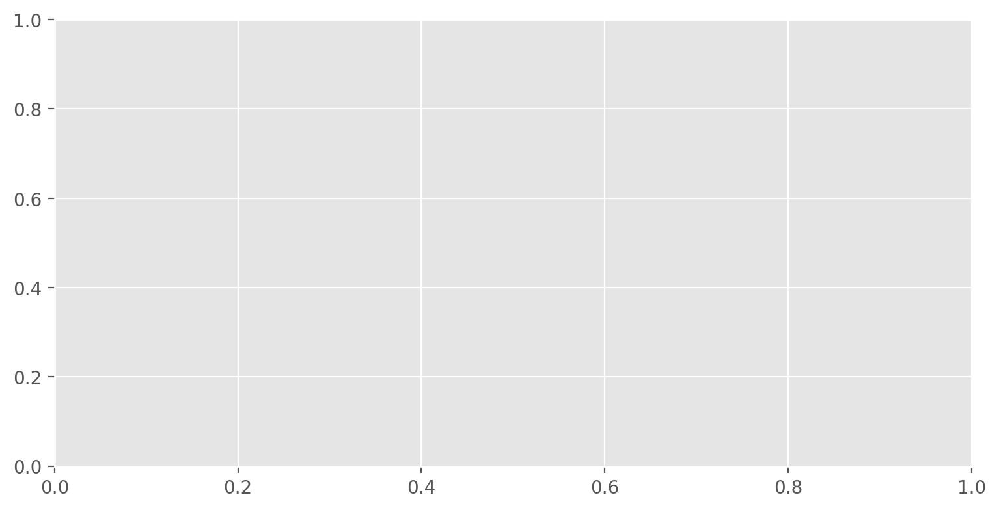

In [38]:
# looking at the state medical facilities

top_community_hosp = df_hosp.nlargest(10,'NumCommunityHealthCenters_HMIS')
top_primary_hosp = df_hosp.nlargest(10,'NumPrimaryHealthCenters_HMIS')
top_rural_hosp = df_hosp.nlargest(10,'NumRuralHospitals_NHP18')
total_hosp =  df_hosp.nlargest(10,'TotalPublicHealthFacilities_HMIS')

plt.figure(figsize = (20,10),dpi = 200)
plt.style.use(u'ggplot')

plt.subplot(2,2,1)

sns.barplot(y = top_community_hosp['State/UT'], x = top_community_hosp['NumCommunityHealthCenters_HMIS'],data= df_hosp,
            orient = 'h' , color = '#58A25D')
plt.xlabel('')
plt.ylabel("")
plt.title('Number of Community Health Centres',fontsize = 17)
plt.tick_params(labelsize = 13)


plt.subplot(2,2,2)

sns.barplot(y = top_rural_hosp['State/UT'], x = top_rural_hosp['NumRuralHospitals_NHP18'],data= df_hosp,
            orient = 'h' , color = '#8ABC7C')
plt.xlabel('')
plt.ylabel("")
plt.title('Number of Rural Health Facilities',fontsize = 17)
plt.tick_params(labelsize = 13)


plt.subplot(2,2,3)

sns.barplot(y = top_primary_hosp['State/UT'], x = top_primary_hosp['NumPrimaryHealthCenters_HMIS'],data= df_hosp,
            orient = 'h' , color = '#00AAAA')
plt.xlabel('')
plt.ylabel("")
plt.title('Number of Primary Health Centres',fontsize = 17)
plt.tick_params(labelsize = 13)


plt.subplot(2,2,4)

sns.barplot(y = total_hosp['State/UT'], x = total_hosp['TotalPublicHealthFacilities_HMIS'],data= df_hosp,
            orient = 'h' , color = '#008B8B')

plt.xlabel('')
plt.ylabel("")
plt.title('Total Public Health Facilities',fontsize = 17)
plt.tick_params(labelsize = 13)

plt.suptitle('State-wise Distribution of Health Facilites',fontsize = 25,x = 0.65)
plt.tight_layout(rect=[0, 0.05, 1.2, 0.95])

Tamil Nadu doesn't rank that high when comparing Total Public Health Facilities. Its low mortality rate can be attributed to faster detection of the virus in patients. Despite having a lot of Public and Rural health facilities, Karnataka is still contending to cure patients.

In [39]:
latest_tests = df_tests.groupby('State').max().sort_values('TotalSamples',ascending = False)[0:20]
latest_tests['Ratio'] = round((latest_tests['Positive']/latest_tests['TotalSamples'])*1000,2)

fig = px.bar(data_frame = latest_tests,
              y  = latest_tests['TotalSamples'],x =  latest_tests['TotalSamples'].index,template = 'ggplot2',text = latest_tests['Ratio'],
              color = latest_tests['Ratio'],color_continuous_scale= px.colors.sequential.Redor,labels = {'x':'State','TotalSamples':'Number of COVID Tests Done',"Ratio":'5Positive Cases for every 1000 tests'},
              height = 600,width  = 1500)

fig.update_layout(title = {
    'text': 'COVID Tests Done vs Positive Cases for Every 1000 tests'
})
fig.update_traces(textposition = 'outside',textfont_size = 13)

Maharashtra,Delhi,Telangana need to increase their testing as >10% of their tests are positive. Our prime weapon against COVID is detection, contact tracing and breaking the chain.

Andhra Pradesh has done well to have a high test rate despite a limited count of health care institutions in state.

Clinical Trials

In [41]:
file ="https://raw.githubusercontent.com/rohitgupta29/AI7-/master/COVID%20clinical%20trials.csv"

trials = pd.read_csv(file)

In [42]:
trials.head()

,Rank,NCT Number,Title,Acronym,Status,Study Results,Conditions,Interventions,Outcome Measures,Sponsor/Collaborators,Gender,Age,Phases,Enrollment,Funded Bys,Study Type,Study Designs,Other IDs,Start Date,Primary Completion Date,Completion Date,First Posted,Results First Posted,Last Update Posted,Locations,Study Documents,URL
0,1,NCT04395482,Lung CT Scan Analysis of SARS-CoV2 Induced Lun...,TAC-COVID19,Recruiting,No Results Available,covid19,Other: Lung CT scan analysis in COVID-19 patients,A qualitative analysis of parenchymal lung dam...,University of Milano Bicocca,All,"18 Years and older (Adult, Older Adult)",NaN,500.0,Other,Observational,Observational Model: Cohort|Time Perspective: ...,TAC-COVID19,"April 15, 2020","June 15, 2020","October 15, 2020","May 20, 2020",NaN,"May 26, 2020","Ospedale Papa Giovanni XXIII, Bergamo, Italy|P...",NaN,https://ClinicalTrials.gov/show/NCT04395482
1,2,NCT04395924,Maternal-foetal Transmission of SARS-Cov-2,TMF-COVID-19,Recruiting,No Results Available,Maternal Fetal Infection Transmission|COVID-19...,Diagnostic Test: Diagnosis of SARS-Cov2 by RT-...,COVID-19 by positive PCR in cord blood and / o...,Centre Hospitalier Régional d'Orléans|Centre d...,Female,18 Years to 48 Years (Adult),NaN,50.0,Other,Observational,Observational Model: Cohort|Time Perspective: ...,CHRO-2020-10,"May 5, 2020",May 2021,May 2021,"May 20, 2020",NaN,"June 4, 2020","CHR Orléans, Orléans, France",NaN,https://ClinicalTrials.gov/show/NCT04395924
2,3,NCT04476940,COVID-19 Breastfeeding Guideline for African-A...,COVID-BF,Not yet recruiting,No Results Available,Covid19|Exclusive Breastfeeding,Behavioral: COVID-19 Breastfeeding Support,COVID-19 breastfeeding guidance adherence at b...,Meharry Medical College,Female,18 Years to 45 Years (Adult),Not Applicable,200.0,Other,Interventional,Allocation: N/A|Intervention Model: Single Gro...,330875,September 2020,October 2021,June 2022,"July 20, 2020",NaN,"July 20, 2020","Meharry Medical College, Nashville, Tennessee,...",NaN,https://ClinicalTrials.gov/show/NCT04476940
3,4,NCT04412265,Frailty in Elderly Patients With COVID-19,FRA-COVID,Recruiting,No Results Available,Covid19,Other: Relation between frailty and clinical o...,"Development of a tool to measure frailty|A ""pr...",University of Milano Bicocca,All,"18 Years and older (Adult, Older Adult)",NaN,300.0,Other,Observational,Observational Model: Case-Only|Time Perspectiv...,FRA-COVID,"March 1, 2020",June 2020,"March 1, 2021","June 2, 2020",NaN,"June 9, 2020","ASST Monza-Ospedale San Gerardo, Monza, Italy",NaN,https://ClinicalTrials.gov/show/NCT04412265
4,5,NCT04427332,Smell and Taste Disorders in COVID-19 Patients,COVID-19 ORL,Recruiting,No Results Available,covid19,Other: Investigation of smell and taste disorders,Identification of demographic and clinical fac...,University of Milano Bicocca,All,"18 Years and older (Adult, Older Adult)",NaN,500.0,Other,Observational,Observational Model: Cohort|Time Perspective: ...,COVID-19 ORL,"May 15, 2020","June 30, 2020","September 30, 2020","June 11, 2020",NaN,"June 11, 2020","ASST Monza-Ospedale San Gerardo, Monza, Italy",NaN,https://ClinicalTrials.gov/show/NCT04427332
